In [1]:
%cd ..

/home/prayson/Code/apartements


In [2]:
import pandas as pd
import numpy as np

In [3]:
df = pd.read_csv("assets/data/bolig.csv.gzip",
                 compression="gzip", 
                 parse_dates=["soldDate"])
df.sample(4)

,estateId,address,zipCode,price,soldDate,propertyType,saleType,sqmPrice,rooms,size,...,change,guid,latitude,longitude,municipalityCode,estateCode,city,groupKey,canGetVR,bfEnr
39308,0,"Linus Paulings Vej 10, st. th",2450,2845000,2020-06-10 22:00:00+00:00,3,Alm. Salg,49051.723,2.0,58,...,0.0,1D1D06D0-738E-4746-8A30-4242608EA32A,55.654346,12.553614,101,41418,København SV,NaN,True,100258570
32588,0,"Händelsvej 12, 2. th",2450,1750000,2021-03-04 23:00:00+00:00,3,Alm. Salg,33018.867,2.0,53,...,0.0,8168BD50-D035-4408-8682-3028AAB1143A,55.649582,12.526423,101,252566,København SV,NaN,True,115953
91767,0,"Griffenfeldsgade 50, 2",2200,4350000,2000-05-01 22:00:00+00:00,3,Alm. Salg,28431.373,6.0,153,...,0.0,D7A1D42D-E821-477A-80B7-BEEF90A6836D,55.686043,12.552433,101,186512,København N,1.0,True,6018430
93294,0,"Olfert Fischers Gade 13, st",1311,1011360,1998-10-02 22:00:00+00:00,3,Alm. Salg,14657.392,2.0,69,...,0.0,9BFB4557-AC7A-47DE-9987-6C708CF28312,55.686714,12.588203,101,964361,København K,NaN,True,124948


In [4]:
LOWER_PRICE, HIGHER_PRICE = 500_000, 9_000_000
NUMBER_OF_ROOMS = 6
SALES_TYPE = 'Alm. Salg'

(df
     .loc[(df['saleType'].eq(SALES_TYPE)) &
           (df['price'].between(LOWER_PRICE, HIGHER_PRICE)) &
           (df['rooms'].lt(NUMBER_OF_ROOMS))
 ]
     .sort_values(by="soldDate")

).sample(5)

,estateId,address,zipCode,price,soldDate,propertyType,saleType,sqmPrice,rooms,size,...,change,guid,latitude,longitude,municipalityCode,estateCode,city,groupKey,canGetVR,bfEnr
47682,0,"Martin Luther Kings Vej 17, 6. 3",2450,7895000,2019-01-27 23:00:00+00:00,3,Alm. Salg,53707.484,4.0,147,...,0.000000,EE05E6FE-1A9D-4A44-9059-18EF7111BC18,55.657955,12.561841,101,24932,København SV,NaN,True,162216
50125,0,"Amager Boulevard 108, st. th",2300,3095000,2018-08-16 22:00:00+00:00,3,Alm. Salg,32239.584,3.0,96,...,0.000000,50F5BF19-1212-48D8-9626-098EDC868600,55.666573,12.593551,101,30534,København S,1.0,True,111412
56629,1308837,"Guldbergsgade 49, 2. tv",2200,2300000,2017-07-20 22:00:00+00:00,3,Alm. Salg,42592.594,2.0,54,...,-2.127660,94902EB6-2E95-432D-ADD4-C82084D250B2,55.693190,12.555432,101,897834,København N,NaN,True,138960
62354,1166777,"Islands Brygge 38B, 7. tv",2300,5145000,2016-06-12 22:00:00+00:00,3,Alm. Salg,50940.594,3.0,101,...,0.000000,9565ECD1-EE92-4AE8-B2F1-94A592261D8A,55.658340,12.566699,101,25113,København S,NaN,True,112396
9042,1091344,"H.V. Nyholms Vej 2, 3. 2",2000,3930000,2015-05-21 22:00:00+00:00,3,Alm. Salg,37428.570,3.0,105,...,-1.627034,EE18F3D7-FB6C-4E29-A033-B8F754793BBD,55.679260,12.513532,147,258355,Frederiksberg,NaN,True,188822


In [5]:
#Sorting fam_salg away
SALES_TYPE = 'Alm. Salg'
#Sorting apartments away that where sold for under 500.000 and above 9.000.000
LOWER_PRICE, HIGHER_PRICE = 500_000, 9_000_000

#Sorting apartments away that have above 5 roomes doe to the likelyhood of it being under 0.001%procent
NUMBER_OF_ROOMS = 5


alm_salg_df = (df
     .loc[(df['saleType'].eq(SALES_TYPE)) &
           (df['price'].between(LOWER_PRICE, HIGHER_PRICE)) &
           (df['rooms'].le(NUMBER_OF_ROOMS))
 ]
     .sort_values(by="soldDate")
)

(alm_salg_df
  .sample(5)
  .loc[:, ["price", "rooms", "size", "soldDate"]]
  .assign(soldAge = lambda d: (d["soldDate"].dt.date - pd.to_datetime("1991-01-01")).dt.days/365)
  .loc[:,["price", "rooms", "size", "soldAge"]] 
)

In [6]:
alm_salg_df.columns

Index(['estateId', 'address', 'zipCode', 'price', 'soldDate', 'propertyType',
       'saleType', 'sqmPrice', 'rooms', 'size', 'buildYear', 'change', 'guid',
       'latitude', 'longitude', 'municipalityCode', 'estateCode', 'city',
       'groupKey', 'canGetVR', 'bfEnr'],
      dtype='object')

In [7]:
features  =['address', 'zipCode', 'soldDate', 'rooms', 'size', 'buildYear',
'latitude', 'longitude', 'municipalityCode', 'estateCode', 'city', 'price',]

alm_salg_df = alm_salg_df[features].astype({"rooms": np.int8, "size": np.int16, "buildYear": np.int32,
                              "municipalityCode": np.int32, "estateCode":np.int32,
                             "zipCode": np.int32})

In [8]:
import hiplot as hip

In [9]:
explore_data = alm_salg_df[features].astype({"rooms": np.int8, "size": np.int16, "buildYear": np.int32,
                              "municipalityCode": np.int32, "estateCode":np.int32,
                             "zipCode": np.int32})
explore_data = (explore_data
                    .assign(soldYear=lambda d: d["soldDate"].dt.year,
                            soldMonth=lambda d: d["soldDate"].dt.month,)
                    .drop(columns=["address", "soldDate"])
                  # after the viz, we discovered Build Year 0 and size 857?
                   .loc[lambda d: (d['buildYear'].ne(0) & d["size"].lt(350))]
                   )

In [10]:
explore_data.columns[::-1]

Index(['soldMonth', 'soldYear', 'price', 'city', 'estateCode',
       'municipalityCode', 'longitude', 'latitude', 'buildYear', 'size',
       'rooms', 'zipCode'],
      dtype='object')

In [11]:
order_columns = ['price',   'size', 'rooms', 'longitude', 'latitude', 
                 'buildYear','soldMonth', 'soldYear','zipCode' , 'city',]

In [12]:
viz = hip.Experiment.from_dataframe(explore_data[order_columns])

In [13]:
viz.display();  # soldMonth has no effect & interestubg suze of 857, I think the correct is 85.7

<IPython.core.display.Javascript object>

In [14]:
interesting_columns = ['price',   'size', 'rooms', 'longitude', 'latitude', 
                 'buildYear', 'soldYear','zipCode' , 'city',]

In [15]:
from sklearn.model_selection import train_test_split

In [16]:
X = explore_data[[ 'size', 'rooms', 'longitude', 'latitude', 
                 'buildYear', 'soldYear','zipCode' , 'city',]]
y = explore_data["price"]

In [17]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=.9, stratify=X["city"])

In [18]:
from sklearn.linear_model import LinearRegression
import patsy as ps

In [19]:
# price ~ (size + C(rooms) + C(soldYear))**2 + (latitude + longitude)**2  - 1"

In [20]:
# price ~ size

In [21]:
y_tra, X_tra = ps.dmatrices( "price ~ size + C(rooms) + C(soldYear) + latitude + longitude - 1", data=X_train.assign(price=y_train))
y_tes, X_tes = ps.dmatrices( "price ~ size + C(rooms) + C(soldYear) + latitude + longitude - 1", data=X_test.assign(price=y_test))

y_tra, y_tes = y_tra.ravel(), y_tes.ravel()

In [22]:
LinearRegression(n_jobs=-1).fit(X_tra, y_tra).score(X_tes, y_tes)

0.45632159990067933

In [23]:
from sklearn.neighbors import KNeighborsRegressor 

In [24]:
KNeighborsRegressor(n_jobs=-1, n_neighbors=5).fit(X_tra, y_tra).score(X_tes, y_tes)

0.5940115558106729

In [25]:
from sklearn.ensemble import GradientBoostingRegressor, ExtraTreesRegressor

In [26]:
GradientBoostingRegressor(learning_rate=0.7, n_estimators=107,).fit(X_tra, y_tra).score(X_tes, y_tes)

0.7154249756034142

In [27]:
ExtraTreesRegressor(n_jobs=-1, n_estimators=107).fit(X_tra, y_tra).score(X_tes, y_tes)

0.8062712326413491

In [28]:
# AutoML do better?

In [29]:
from flaml import AutoML

In [30]:
automl = AutoML()
automl_settings = {
    "time_budget": 60*5,  # in seconds
    "metric": 'r2',
    "task": 'regression',
    "log_file_name": "bolig.log",
    "n_jobs": -1,
}

automl.fit(X_train=X_tra, y_train=y_tra, **automl_settings)

[flaml.automl.logger: 11-08 17:20:32] {1679} INFO - task = regression
[flaml.automl.logger: 11-08 17:20:32] {1690} INFO - Evaluation method: holdout
[flaml.automl.logger: 11-08 17:20:32] {1788} INFO - Minimizing error metric: 1-r2
[flaml.automl.logger: 11-08 17:20:32] {1900} INFO - List of ML learners in AutoML Run: ['lgbm', 'rf', 'catboost', 'xgboost', 'extra_tree', 'xgb_limitdepth']
[flaml.automl.logger: 11-08 17:20:32] {2218} INFO - iteration 0, current learner lgbm
[flaml.automl.logger: 11-08 17:20:32] {2344} INFO - Estimated sufficient time budget=2695s. Estimated necessary time budget=23s.
[flaml.automl.logger: 11-08 17:20:32] {2391} INFO -  at 0.1s,	estimator lgbm's best error=0.8313,	best estimator lgbm's best error=0.8313
[flaml.automl.logger: 11-08 17:20:32] {2218} INFO - iteration 1, current learner lgbm
[flaml.automl.logger: 11-08 17:20:33] {2391} INFO -  at 0.1s,	estimator lgbm's best error=0.8313,	best estimator lgbm's best error=0.8313
[flaml.automl.logger: 11-08 17:20:3

In [31]:
automl.score(X_tes, y_tes)

0.8635207089898056

In [32]:
automl.best_estimator, automl.best_config_per_estimator.get(automl.best_estimator)

('xgb_limitdepth',
 {'n_estimators': 1367,
  'max_depth': 13,
  'min_child_weight': 1.2304592330449473,
  'learning_rate': 0.13607985924942162,
  'subsample': 0.8809985595678514,
  'colsample_bylevel': 0.6110905249174567,
  'colsample_bytree': 0.5178683203942773,
  'reg_alpha': 0.23841045432194558,
  'reg_lambda': 2.1754940808143233})

In [33]:
from autogluon.tabular import TabularPredictor, TabularDataset

/home/prayson/.cache/pypoetry/virtualenvs/mining-OVdcBreE-py3.10/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [34]:
X_tes.design_info.column_names

['C(rooms)[1]',
 'C(rooms)[2]',
 'C(rooms)[3]',
 'C(rooms)[4]',
 'C(rooms)[5]',
 'C(soldYear)[T.1993]',
 'C(soldYear)[T.1994]',
 'C(soldYear)[T.1995]',
 'C(soldYear)[T.1996]',
 'C(soldYear)[T.1997]',
 'C(soldYear)[T.1998]',
 'C(soldYear)[T.1999]',
 'C(soldYear)[T.2000]',
 'C(soldYear)[T.2001]',
 'C(soldYear)[T.2002]',
 'C(soldYear)[T.2003]',
 'C(soldYear)[T.2004]',
 'C(soldYear)[T.2005]',
 'C(soldYear)[T.2006]',
 'C(soldYear)[T.2007]',
 'C(soldYear)[T.2008]',
 'C(soldYear)[T.2009]',
 'C(soldYear)[T.2010]',
 'C(soldYear)[T.2011]',
 'C(soldYear)[T.2012]',
 'C(soldYear)[T.2013]',
 'C(soldYear)[T.2014]',
 'C(soldYear)[T.2015]',
 'C(soldYear)[T.2016]',
 'C(soldYear)[T.2017]',
 'C(soldYear)[T.2018]',
 'C(soldYear)[T.2019]',
 'C(soldYear)[T.2020]',
 'C(soldYear)[T.2021]',
 'C(soldYear)[T.2022]',
 'C(soldYear)[T.2023]',
 'size',
 'latitude',
 'longitude']

In [35]:
train_data_ = TabularDataset(pd.DataFrame(X_tra.view(), columns=X_tra.design_info.column_names).assign(price=y_tra))
test_data_ = TabularDataset(pd.DataFrame(X_tes.view(), columns=X_tes.design_info.column_names).assign(price=y_tes))

In [52]:
predictor = TabularPredictor("price", problem_type='regression', 
                             path="./notebooks/models", 
                             eval_metric="r2").fit(train_data_)

Beginning AutoGluon training ...
AutoGluon will save models to "./notebooks/models/"
AutoGluon Version:  0.8.2
Python Version:     3.10.10
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #35~22.04.1-Ubuntu SMP PREEMPT_DYNAMIC Fri Oct  6 10:23:26 UTC 2
Disk Space Avail:   853.03 GB / 1006.45 GB (84.8%)
Train Data Rows:    60768
Train Data Columns: 39
Label Column: price
Preprocessing data ...
Using Feature Generators to preprocess the data ...
Fitting AutoMLPipelineFeatureGenerator...
	Available Memory:                    24554.41 MB
	Train Data (Original)  Memory Usage: 18.96 MB (0.1% of available memory)
	Inferring data type of each feature based on column values. Set feature_metadata_in to manually specify special dtypes of the features.
	Stage 1 Generators:
		Fitting AsTypeFeatureGenerator...
			Note: Converting 36 features to boolean dtype as they only contain 2 unique values.
	Stage 2 Generators:
		Fitting FillNaFeatureGenerator...
	Stage 3 Generators:
		F

[1000]	valid_set's l2: 8.1395e+11	valid_set's r2: 0.748041
[2000]	valid_set's l2: 7.25128e+11	valid_set's r2: 0.775536
[3000]	valid_set's l2: 6.80945e+11	valid_set's r2: 0.789213
[4000]	valid_set's l2: 6.52574e+11	valid_set's r2: 0.797995
[5000]	valid_set's l2: 6.31886e+11	valid_set's r2: 0.804399
[6000]	valid_set's l2: 6.17528e+11	valid_set's r2: 0.808843
[7000]	valid_set's l2: 6.06618e+11	valid_set's r2: 0.812221
[8000]	valid_set's l2: 5.96699e+11	valid_set's r2: 0.815291
[9000]	valid_set's l2: 5.90421e+11	valid_set's r2: 0.817234
[10000]	valid_set's l2: 5.83525e+11	valid_set's r2: 0.819369


	0.8194	 = Validation score   (r2)
	12.38s	 = Training   runtime
	0.51s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's l2: 6.29895e+11	valid_set's r2: 0.805015
[2000]	valid_set's l2: 5.56504e+11	valid_set's r2: 0.827733
[3000]	valid_set's l2: 5.28066e+11	valid_set's r2: 0.836537
[4000]	valid_set's l2: 5.08757e+11	valid_set's r2: 0.842514
[5000]	valid_set's l2: 4.97541e+11	valid_set's r2: 0.845986
[6000]	valid_set's l2: 4.91333e+11	valid_set's r2: 0.847907
[7000]	valid_set's l2: 4.84884e+11	valid_set's r2: 0.849903
[8000]	valid_set's l2: 4.81531e+11	valid_set's r2: 0.850941
[9000]	valid_set's l2: 4.78892e+11	valid_set's r2: 0.851758
[10000]	valid_set's l2: 4.78482e+11	valid_set's r2: 0.851885


	0.852	 = Validation score   (r2)
	11.91s	 = Training   runtime
	0.43s	 = Validation runtime
Fitting model: RandomForestMSE ...
	0.8201	 = Validation score   (r2)
	15.44s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: CatBoost ...
	0.857	 = Validation score   (r2)
	117.43s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: ExtraTreesMSE ...
	0.8166	 = Validation score   (r2)
	7.78s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	0.7427	 = Validation score   (r2)
	46.17s	 = Training   runtime
	0.03s	 = Validation runtime
Fitting model: XGBoost ...
	0.8521	 = Validation score   (r2)
	25.32s	 = Training   runtime
	0.35s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	0.6972	 = Validation score   (r2)
	113.07s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...


[1000]	valid_set's l2: 4.78365e+11	valid_set's r2: 0.851922
[2000]	valid_set's l2: 4.48367e+11	valid_set's r2: 0.861207
[3000]	valid_set's l2: 4.38815e+11	valid_set's r2: 0.864164
[4000]	valid_set's l2: 4.36419e+11	valid_set's r2: 0.864906
[5000]	valid_set's l2: 4.35911e+11	valid_set's r2: 0.865063
[6000]	valid_set's l2: 4.36266e+11	valid_set's r2: 0.864953


	0.8652	 = Validation score   (r2)
	14.34s	 = Training   runtime
	0.22s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	0.8701	 = Validation score   (r2)
	0.35s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 368.69s ... Best model: "WeightedEnsemble_L2"
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("./notebooks/models/")


In [53]:
predictor.evaluate(test_data_, silent=True)

{'r2': 0.8584157894286694,
 'root_mean_squared_error': array(-684238.52219574),
 'mean_squared_error': -468182355256.6102,
 'mean_absolute_error': -413308.43055169925,
 'pearsonr': 0.9267297541734899,
 'median_absolute_error': -242393.5}

In [54]:
predictor.leaderboard(silent=True)

,model,score_val,pred_time_val,fit_time,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,0.870124,0.603296,270.547054,0.000428,0.352585,2,True,12
1,LightGBMLarge,0.865243,0.215656,14.340250,0.215656,14.340250,1,True,11
2,CatBoost,0.856975,0.005466,117.434419,0.005466,117.434419,1,True,6
3,XGBoost,0.852083,0.347932,25.315585,0.347932,25.315585,1,True,9
4,LightGBM,0.852026,0.427196,11.907867,0.427196,11.907867,1,True,4
5,RandomForestMSE,0.820102,0.056608,15.440351,0.056608,15.440351,1,True,5
6,LightGBMXT,0.819378,0.507253,12.383921,0.507253,12.383921,1,True,3
7,ExtraTreesMSE,0.816644,0.067867,7.780225,0.067867,7.780225,1,True,7
8,NeuralNetFastAI,0.742665,0.028308,46.165856,0.028308,46.165856,1,True,8
9,NeuralNetTorch,0.697165,0.008480,113.074249,0.008480,113.074249,1,True,10


In [55]:
predictor.fit_summary(show_plot=True, verbosity=0)

{'model_types': {'KNeighborsUnif': 'KNNModel',
  'KNeighborsDist': 'KNNModel',
  'LightGBMXT': 'LGBModel',
  'LightGBM': 'LGBModel',
  'RandomForestMSE': 'RFModel',
  'CatBoost': 'CatBoostModel',
  'ExtraTreesMSE': 'XTModel',
  'NeuralNetFastAI': 'NNFastAiTabularModel',
  'XGBoost': 'XGBoostModel',
  'NeuralNetTorch': 'TabularNeuralNetTorchModel',
  'LightGBMLarge': 'LGBModel',
  'WeightedEnsemble_L2': 'WeightedEnsembleModel'},
 'model_performance': {'KNeighborsUnif': 0.4519773142348813,
  'KNeighborsDist': 0.4215113429664623,
  'LightGBMXT': 0.8193777127038449,
  'LightGBM': 0.8520256570880345,
  'RandomForestMSE': 0.8201020656023863,
  'CatBoost': 0.8569748638500557,
  'ExtraTreesMSE': 0.8166435292321641,
  'NeuralNetFastAI': 0.7426647362790302,
  'XGBoost': 0.8520830300922457,
  'NeuralNetTorch': 0.697164686800441,
  'LightGBMLarge': 0.8652433316949557,
  'WeightedEnsemble_L2': 0.8701235755229629},
 'model_best': 'WeightedEnsemble_L2',
 'model_paths': {'KNeighborsUnif': './notebooks

In [56]:
pd.DataFrame(predictor.fit_summary(verbosity=0)).head(3)

,model_types,model_performance,model_best,model_paths,model_fit_times,model_pred_times,num_bag_folds,max_stack_level,model_hyperparams
KNeighborsUnif,KNNModel,0.451977,WeightedEnsemble_L2,./notebooks/models/models/KNeighborsUnif/,0.032247,0.026584,0,2,{'weights': 'uniform'}
KNeighborsDist,KNNModel,0.421511,WeightedEnsemble_L2,./notebooks/models/models/KNeighborsDist/,0.029965,0.025334,0,2,{'weights': 'distance'}
LightGBMXT,LGBModel,0.819378,WeightedEnsemble_L2,./notebooks/models/models/LightGBMXT/,12.383921,0.507253,0,2,"{'learning_rate': 0.05, 'extra_trees': True}"


In [57]:
predictor.get_model_best()

'WeightedEnsemble_L2'

In [58]:
pred_price = predictor.predict(test_data_, model=predictor.get_model_best()).round(0)

In [59]:
from sklearn.metrics import r2_score

In [60]:
r2_score(y_true=test_data_.price, y_pred=pred_price)

0.8584157883450315

In [61]:
predictor = automl

In [62]:
predicted_price = predictor.predict(X_tes).round(0).astype(int)

In [63]:
pd.options.plotting.backend = "plotly"

In [64]:
p = ( pd
     .DataFrame({"actual_price": y_tes, "predicted_price": predicted_price, "size": test_data_["size"].astype(int)})
     .assign(residual = lambda d: d["actual_price"] - d["predicted_price"],
             under_estimate = lambda d: d["residual"] < 0 )
     #.sort_values(by=["actual_price", "predicted_price"]
     .reset_index(drop=True)
)

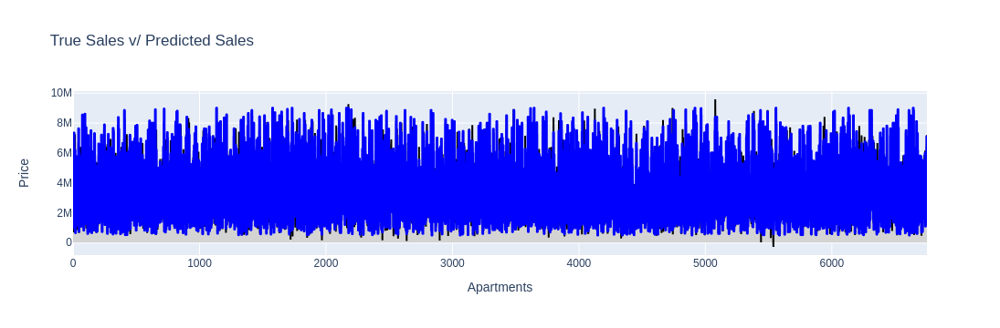

In [65]:
(p
 .plot(kind="line", y="actual_price", title=f"True Sales v/ Predicted Sales", )
 .update_traces(line = dict(color = 'blue', width=3))
 
  .update_layout(hovermode="x unified", 
                 xaxis_title="Apartments",
                yaxis_title="Price",)

  # .add_traces(p.plot(kind="line", y="predicted_price")
  #            .update_traces(line = dict(color = 'black', width=2)
  #                                                                  ).data
  #           )
 .add_traces(p.plot(kind="area", y="predicted_price")
             .update_traces( 
                            line= dict(color = 'black', width=2),
                            fill='tonexty',
                            fillcolor="lightgrey",
                            
                                                 ).data
            )
 
)

In [66]:
p

,actual_price,predicted_price,size,residual,under_estimate
0,2100000.0,2804814,83,-704814.0,True
1,2500000.0,2956088,59,-456088.0,True
2,6300000.0,6309361,42,-9361.0,True
3,2950000.0,2794064,66,155936.0,False
4,7175000.0,6480102,128,694898.0,False
...,...,...,...,...,...
6748,2345000.0,2611480,56,-266480.0,True
6749,2675000.0,2699786,77,-24786.0,True
6750,5295000.0,6111492,143,-816492.0,True
6751,7095000.0,7172954,123,-77954.0,True


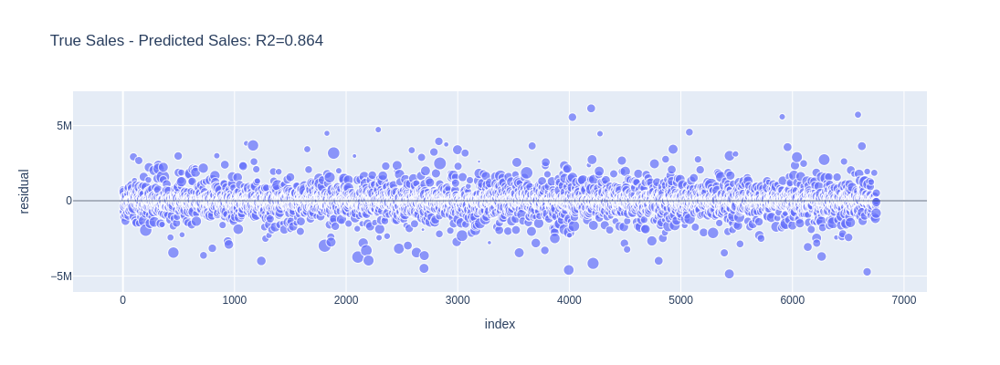

In [67]:
fig_size = {"width":1200, "height":400}
R2 = predictor.score(X_tes, y_tes).round(3)

(   p.plot(kind="scatter",
           y="residual",
           x=p.index,
           size="size",
           size_max=15,
           title=f"True Sales - Predicted Sales: {R2=} ",
           **fig_size
          )
     .add_hline(y=0, opacity=0.4, )
     .update_traces(mode="markers")
     .update_layout(hovermode="y")
)